In [5]:
from MagicCube import MagicCube
import time
import matplotlib.pyplot as plt

In [ ]:
def hillClimbingWSM(cube, maxIter=100, maxSideways=15):
    iteration = 0
    sidewaysCount = 0
    history = []
    timeStart = time.time()

    # Menyimpan nilai objective function awal   
    current_objfunc = cube.objective_function()
    history.append(current_objfunc)

    # Terdapat 3 kondisi untuk hasil dari SidewaysMove
    # 1. Jika iterasi sudah mencapai maksimal, mengeluarkan kondisi current state
    while iteration < maxIter:
        nextStates = cube.next_states()
        bestStates = None
        bestNeighbor_objfunc = current_objfunc

        # Mencari state terbaik di neighbor
        for next_state in nextStates:
            neighbor_objfunc = next_state.objective_function()
            print(f"Iterasi {iteration}: Current: {current_objfunc}, Neighbor: {neighbor_objfunc}")

            if neighbor_objfunc < bestNeighbor_objfunc:
                bestStates = next_state
                bestNeighbor_objfunc = neighbor_objfunc

        # Jika menemukan neighbor yang lebih baik, perbarui state
        if bestStates:
            cube = bestStates
            current_objfunc = bestNeighbor_objfunc
            history.append(current_objfunc)
            sidewaysCount = 0  # Reset sideways move counter
            iteration += 1

        # Jika tidak ada neighbor yang lebih baik tetapi ada yang nilainya sama, 
        # mengambil salah satu neighbor dengan nilai yang sama lalu menghitung sideways
        elif current_objfunc == bestNeighbor_objfunc and sidewaysCount < maxSideways:
            # Lakukan *sideways move*
            for next_state in nextStates:
                neighbor_objfunc = next_state.objective_function()
                if neighbor_objfunc == current_objfunc:
                    cube = next_state
                    sidewaysCount += 1
                    print(f"Sideways move #{sidewaysCount} at Iterasi {iteration}")
                    break  # Pindah ke state yang sama, lalu lanjutkan
            iteration += 1  # Tambahkan iterasi setelah sideways move

        else:
            # 2. Jika tidak ada neighbor yang lebih baik atau sama dan sideways limit tercapai, berhenti
            print("Tidak ada solusi yang lebih baik atau sideways limit tercapai, berhenti pada local maximum atau plateau")
            break

        # 3. Jika solusi valid ditemukan, berhenti
        if cube.is_valid_magic_cube():
            print(f"Solusi ditemukan setelah {iteration} iterasi.")
            break

    duration = time.time() - timeStart
    print(f"Final State: {current_objfunc}")
    return cube, history, iteration, duration


In [7]:
# Visualisasi dari kode
def visualize_experiment(initial_cube, final_cube, history):
    print("Initial State:")
    initial_cube.visualize()

    print("Final State:")
    final_cube.visualize()

    plt.plot(range(len(history)), history, color='blue')
    plt.title('Objective Function terhadap Banyak Iterasi')
    plt.xlabel('Iterasi')
    plt.ylabel('Objective Function (f(x))')
    plt.grid(True)
    plt.show()

Sbarisx: 7875
Skolomx: 7875
Stiangx: 7875
Sdiagonal_bidangx: 3319
Sdiagonal_ruangx: 1122
Objective function: 6269
Sbarisx: 7875
Skolomx: 7875
Stiangx: 7875
Sdiagonal_bidangx: 3332
Sdiagonal_ruangx: 1135
Objective function: 6243
Iterasi 0: Current: 6269, Neighbor: 6243
Sbarisx: 7875
Skolomx: 7875
Stiangx: 7875
Sdiagonal_bidangx: 3416
Sdiagonal_ruangx: 1219
Objective function: 6075
Iterasi 0: Current: 6269, Neighbor: 6075
Sbarisx: 7875
Skolomx: 7875
Stiangx: 7875
Sdiagonal_bidangx: 3357
Sdiagonal_ruangx: 1160
Objective function: 6193
Iterasi 0: Current: 6269, Neighbor: 6193
Sbarisx: 7875
Skolomx: 7875
Stiangx: 7875
Sdiagonal_bidangx: 3319
Sdiagonal_ruangx: 1122
Objective function: 6269
Iterasi 0: Current: 6269, Neighbor: 6269
Sbarisx: 7875
Skolomx: 7875
Stiangx: 7875
Sdiagonal_bidangx: 3387
Sdiagonal_ruangx: 1190
Objective function: 6133
Iterasi 0: Current: 6269, Neighbor: 6133
Sbarisx: 7875
Skolomx: 7875
Stiangx: 7875
Sdiagonal_bidangx: 3319
Sdiagonal_ruangx: 1209
Objective function: 61

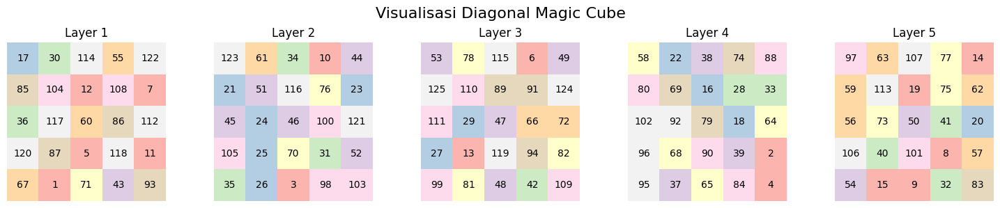

Final State:


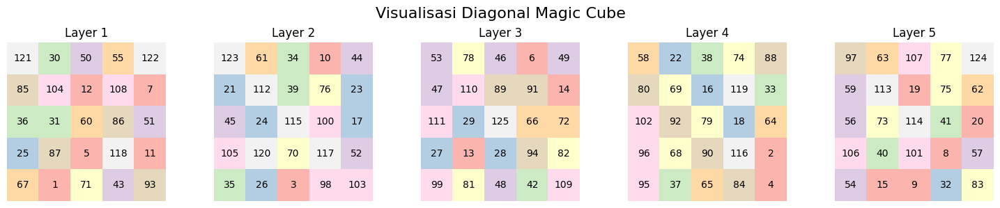

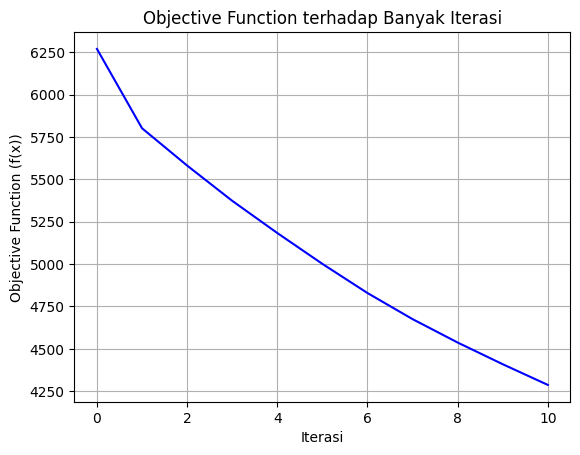

In [8]:
# Menjalankan kode
if __name__ == "__main__":
    initial_cube = MagicCube(n=5)

    final_cube, history, iterations, duration = sideways_move_hill_climbing(initial_cube)

    print(f"Total Iterasi: {iterations}")
    print(f"Durasi: {duration:.2f} detik")
    visualize_experiment(initial_cube, final_cube, history)